# Lyft Motion Prediction: Data Exploration & Baseline

**Credits**: This work adapts and combines community notebooks, including the map API visualiser【125†filecite】, scene visualisations【125†filecite】, and a PyTorch baseline【125†filecite】.  

## Introduction

Lyft’s Level‑5 motion prediction task asks us to forecast the paths of vehicles, cyclists and pedestrians to support autonomous driving.  The data is stored in **Zarr** format and organised into scenes (roughly a minute long) with agents, frames and traffic light states.  In this notebook we’ll:

1. Explore the dataset structure and visualise agents and maps.
2. Summarise metadata (scenes, agent positions, extents, yaw).
3. Preview simple augmentations.
4. Train a baseline model using **Catalyst** and **Kekas**, leaving the model code untouched.

Where appropriate, we’ll keep short commentary under plots to highlight important patterns.

## Setup

The following cell installs extra packages and imports all required libraries (L5Kit, Catalyst, Albumentations, etc.).  It also sets `L5KIT_DATA_FOLDER` and reads a visualisation config.  Run this once before any other cell.

In [1]:
!pip install "segmentation_models_pytorch==0.2.1" hydra-core kekas -U -q
!pip install --target=/kaggle/working pymap3d==2.1.0 -q
!pip install --target=/kaggle/working strictyaml -q
!pip install --target=/kaggle/working protobuf==3.12.2 -q
!pip install --target=/kaggle/working transforms3d -q
!pip install --target=/kaggle/working zarr -q
!pip install --target=/kaggle/working ptable -q
!pip install --no-dependencies --target=/kaggle/working l5kit==1.1.0 --upgrade -q

import sys, os
sys.path.append('/kaggle/working')     # so pip --target modules are importable
os.environ["WANDB_DISABLED"] = "true"  # prevent "W&B installed but not logged in" noise

!cp ../input/lyft-config-files/agent_motion_config.yaml config.yaml
import l5kit, os, albumentations as A
from l5kit.rasterization import build_rasterizer
from l5kit.configs import load_config_data
from l5kit.visualization import draw_trajectory, TARGET_POINTS_COLOR
from tqdm import tqdm
from l5kit.geometry import transform_points
from collections import Counter
from l5kit.data import PERCEPTION_LABELS
from prettytable import PrettyTable
import matplotlib.pyplot as plt
# set env variable for data
os.environ["L5KIT_DATA_FOLDER"] = "../input/lyft-motion-prediction-autonomous-vehicles"
# get config
MONITORING = False # set this to false if you want to fork and train
if MONITORING:
    import utilsforlyft as U
cfg = load_config_data("../input/lyft-config-files/visualisation_config.yaml")
import plotly.offline as py
import omegaconf
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import torch
import torch.nn.functional as F
import torch.nn as nn
from catalyst import dl, data
from catalyst.utils import metrics
from torch.utils.data import DataLoader
from catalyst.dl import utils, BatchOverfitCallback
from torch.optim.lr_scheduler import OneCycleLR
import segmentation_models_pytorch as smp
from catalyst.core.callbacks.early_stop import EarlyStoppingCallback
if MONITORING:
    from catalyst.contrib.dl.callbacks.neptune_logger import NeptuneLogger
    from catalyst.contrib.dl.callbacks import WandbLogger
    neptune_logger = NeptuneLogger(
                    api_token=U.TOKEN + '=',  
                    project_name="trigram19/"+U.NAME_PROJ,
                    offline_mode=False, 
                    name=U.NAME,
                    params={'epoch_nr': 5}, 
                    properties={'data_source': 'lyft'},  
                    tags=['resnet']
                    )

from IPython.display import display, clear_output, HTML
import PIL
import matplotlib.pyplot as plt
from matplotlib import animation as ani, rc
import numpy as np
import warnings; warnings.filterwarnings('ignore')
from l5kit.rasterization.rasterizer_builder import _load_metadata
from kekas import Keker, DataOwner, DataKek
from kekas.utils import DotDict
from kekas.transformations import Transformer, to_torch, normalize

You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.
ERROR: After October 2020 you may experience errors when installing or updating packages. This is because pip will change the way that it resolves dependency conflicts.

We recommend you use --use-feature=2020-resolver to test your packages with the new resolver before it becomes the default.

osmnx 0.15.1 requires geopandas>=0.7, but you'll have geopandas 0.6.3 which is incompatible.
kubernetes 10.1.0 requires pyyaml~=3.12, but you'll have pyyaml 5.3.1 which is incompatible.
jupyterlab-git 0.10.0 requires nbdime<2.0.0,>=1.1.0, but you'll have nbdime 2.0.0 which is incompatible.
hypertools 0.6.2 requires scikit-learn<0.22,>=0.19.1, but you'll have scikit-learn 0.23.2 which is incompatible.
google-cloud-pubsub 1.4.3 requires google-api-core[grpc]<1.17.0,>=1.14.0, but you'll have googl

wandb: WARNING W&B installed but not logged in.  Run `wandb login` or set the WANDB_API_KEY env variable.
/opt/conda/lib/python3.7/site-packages/tqdm/std.py:666: FutureWarning:

The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version



## Monitoring (Optional)

If `MONITORING` is set to `True`, the notebook initialises Neptune.ai and WandB callbacks.  These callbacks log training metrics; if you don’t wish to log externally, set `MONITORING=False`.

## Helper Functions

We define a few helper functions to visualise the Bird’s‑Eye‑View (BEV) raster:

- `plot_image(map_type, ax, agent=False)` renders a BEV with the future trajectory of the target agent overlaid.
- `animation(type_)` generates a simple animation of BEV frames.
- `plot_with_tfms(tf)` previews Albumentations transforms on images plus keypoints.

These helpers do not modify the dataset; they only aid inspection.

In [2]:
def plot_image(map_type, ax, agent=False):
    cfg["raster_params"]["map_type"] = map_type
    rast = build_rasterizer(cfg, dm)
    if agent:
        dataset = AgentDataset(cfg, zarr_dataset, rast)
    else:
        dataset = EgoDataset(cfg, zarr_dataset, rast)
    scene_idx = 2
    indexes = dataset.get_scene_indices(scene_idx)
    images = []
    for idx in indexes:    
        data = dataset[idx]
        im = data["image"].transpose(1, 2, 0)
        im = dataset.rasterizer.to_rgb(im)
        target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
        center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
        draw_trajectory(im, target_positions_pixels, TARGET_POINTS_COLOR, yaws=data["target_yaws"])
        clear_output(wait=True)
        ax.imshow(im[::-1])
                
def animate_solution(images):
    def animate(i):
        im.set_data(images[i]) 
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])    
    return ani.FuncAnimation(fig, animate, frames=len(images), interval=60)

def animation(type_):
    cfg["raster_params"]["map_type"] = type_
    rast = build_rasterizer(cfg, dm)
    dataset = EgoDataset(cfg, zarr_dataset, rast)
    scene_idx = 34
    indexes = dataset.get_scene_indices(scene_idx)
    images = []
    for idx in indexes:    
        data = dataset[idx]
        im = data["image"].transpose(1, 2, 0)
        im = dataset.rasterizer.to_rgb(im)
        target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
        center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
        draw_trajectory(im, target_positions_pixels, TARGET_POINTS_COLOR, yaws=data["target_yaws"])
        clear_output(wait=True)
        images.append(PIL.Image.fromarray(im[::-1]))
    anim = animate_solution(images)
    return HTML(anim.to_jshtml())

def plot_with_tfms(tf):
    tfms = A.Compose(tf, keypoint_params=A.KeypointParams(format="xy", remove_invisible=False))
    im = tfms(image=train_dataset_a[0]['image'], keypoints=train_dataset_a[0]['target_positions'])
    keypoints = im['keypoints']
    im = train_dataset_a.rasterizer.to_rgb(im['image'].transpose(1, 2, 0))
    plt.imshow(im, cmap='Reds');
    


## Load Configuration and Dataset

We now create a `LocalDataManager`, load the validation Zarr file, and build the rasteriser according to the visualisation config.  Opening the dataset prints its metadata (number of scenes, frames, agents).

Run this cell to make `dm`, `zarr_dataset`, `train_dataset_a` and related objects available.

In [3]:
from l5kit.data import ChunkedDataset, LocalDataManager
from l5kit.dataset import EgoDataset, AgentDataset
dm = LocalDataManager()
dataset_path = dm.require(cfg["val_data_loader"]["key"]);rasterizer = build_rasterizer(cfg, dm)
zarr_dataset = ChunkedDataset(dataset_path)
train_dataset_a = AgentDataset(cfg, zarr_dataset, rasterizer)
zarr_dataset.open()
print(zarr_dataset)

+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Num TR lights | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|    100     |   24838    |  1893736   |     316008    |       0.69      |        248.38        |        76.24         |        24.83         |        10.00        |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+


## Quick BEV Visualisation

The next cells call `plot_image` to render a **semantic** map (`py_semantic`) and a **satellite** map (`py_satellite`):

- In the semantic view, the green blob shows the autonomous vehicle (AV); you’ll need to predict its trajectory amid the surrounding agents【126†filecite】.
- The satellite view reveals finer detail: road edges, intersections, and lane markings【126†filecite】.  Green still marks the AV while blue indicates other vehicles.

Examine these plots to confirm that the raster and coordinates align with expectations.

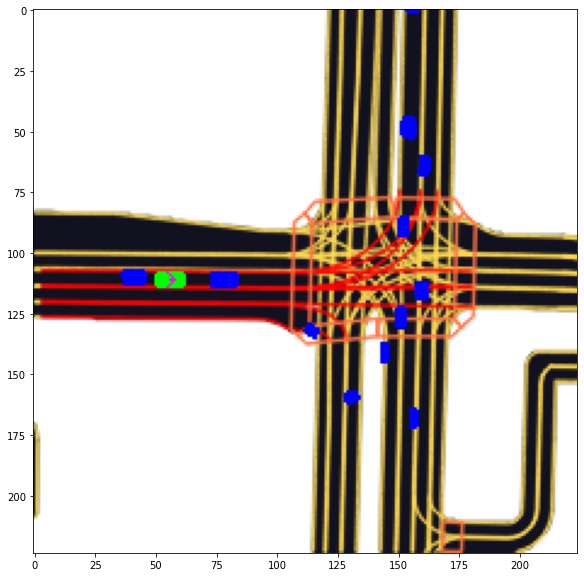

In [4]:
fig, axes = plt.subplots(1, 1, figsize=(15, 10))
for i, key in enumerate(["py_semantic"]):
    plot_image(key, ax=axes)

So, there's a lot of information in this one image. I'll try my best to point everything out, but do notify me if I make any errors. OK, let's get started with dissecting the image:
+ We have an intersection of four roads over here.
+ The green blob represents the AV's motion, and we would require to predict the movement of the AV in these traffic conditions as a sample.

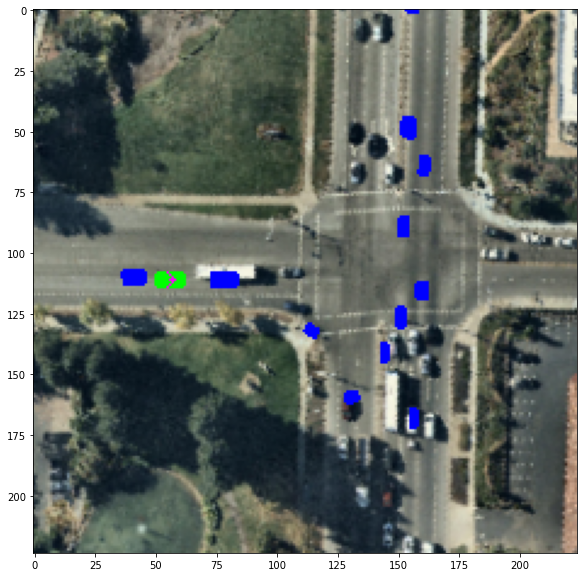

In [5]:
fig, axes = plt.subplots(1, 1, figsize=(15, 10))
for i, key in enumerate(["py_satellite"]):
    plot_image(key, ax=axes)

Yes! This allows for far more detail than a simple plot without detail. I'd haphazard an educated guess, and make the following inferences:
+ Green still represents the autonomous vehicle (AV), and blue is primarily all the other cars/vehicles/exogenous factors we need to predict for.
+ My hypothesis is that the blue represents the path the vehicle needs to go through.
+ If we are able to accurately predict the path the vehicles go through, it will make it easier for an AV to compute its trajectory on the fly.

## BEV Animations

We next call `animation("py_satellite")` and `animation("py_semantic")` to animate a full scene.  Watch how the AV (green) moves relative to other agents (blue).  A straight path in the example suggests minimal interaction, but more complex scenes may show merges or turns.

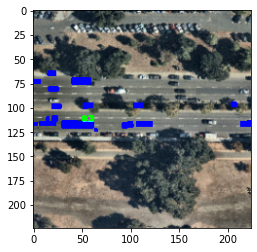

In [6]:
animation("py_satellite")

So this is a demonstration of the movement of the other vehicles and (in relation to the movement and placement of the other vehicles) the movement of the AV. The AV is currently taking only a straight path in its motion, and a straight path seems logical with the movement and placement of other vehicles.

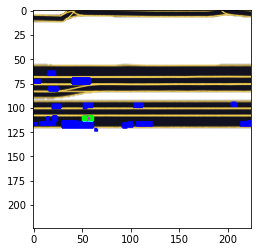

In [7]:
animation("py_semantic")

We're also able to take a more low-level move by using the semantic option in the Lyft level 5 kit. Or... we can go even deeper and use the box rasterizer.

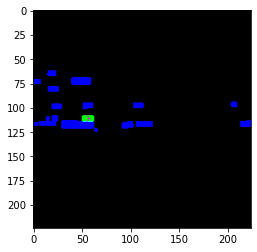

In [8]:
animation("box_debug")

The semantic view is good for a less clustered view but if we want a more detailed, more high-level overview of the data we should perhaps try to use the satellite view voer semantic.

## Agent Perspective

Switching `agent=True` in `plot_image` centres the raster on a target agent rather than the ego vehicle.  This is useful for modelling non‑ego trajectories.  Compare semantic vs satellite vs box/stub views for the AgentDataset to understand how much context remains when centred on each agent.

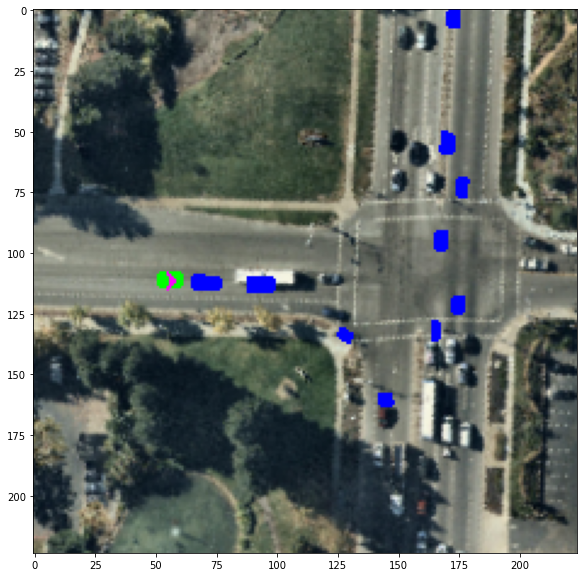

In [9]:
fig, axes = plt.subplots(1, 1, figsize=(15, 10))
for i, key in enumerate(["py_satellite"]):
    plot_image(key, ax=axes, agent=True)

So yes, I probably should save these as a GIF to visualize the agent movements. Let's try a simpler form of this and use the semantic view for the agent dataset.

Uh it seems the rasterizer renders rather well the satellite and semantic views, and both in conjunction help one to get a good sense of the positioning of each vehicle in relation to the road. You can easily understand the placement and motion of the vehicles and highway layout in satellite by taking a good look at the semantic view too.

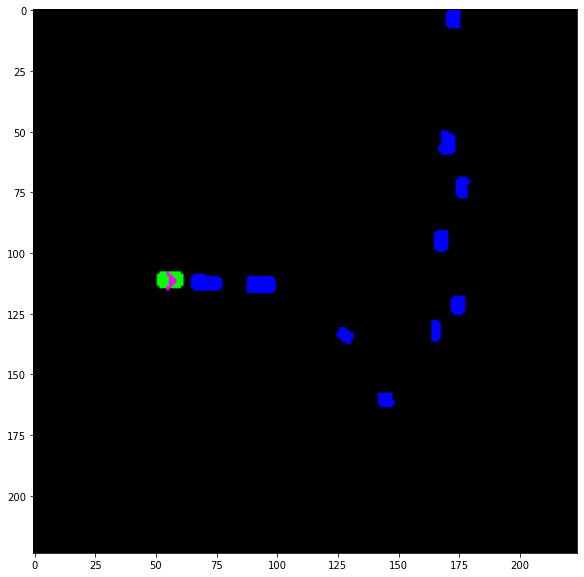

In [10]:
fig, axes = plt.subplots(1, 1, figsize=(15, 10))
for i, key in enumerate(["py_satellite", "py_semantic", 'stub_debug', "box_debug"]):
    plot_image(key, ax=axes, agent=True)

Again, box and stub will also give a good representaton of the data albeit with less low-level detail than the semantic view, seeing as the highways are not into much consideration here. The box view helps to just take a low-level look at the vehicles and their projected path whereas the stub view functions similarly to semantic. We can now proceed to taking a good look at the metadata provided by kkiller and potentially train a good model. The ones to check now will be stub and satellite to check.

Now as you can see with stub and box, under the hood the function uses the keys to create a rasterizer (for stub_debug for example StubRasterizer), which generates the AV surroundings and paths and passes it to an AgentDataset, with which we use to generate the predictions with our model. Also, there's a lot of meta-info about the rasterization that I want to have a look at, so let's look at metadata.

## Scene Metadata

To inspect scene metadata, we convert the `scenes` array into a DataFrame with columns like `frame_index_interval`, `host`, `start_time`, and `end_time`.  This helps ensure no leakage when splitting by scene for training/validation.

In [11]:
print("scenes", zarr_dataset.scenes)
print("scenes[0]", zarr_dataset.scenes[0])

scenes <zarr.core.Array '/scenes' (100,) [('frame_index_interval', '<i8', (2,)), ('host', '<U16'), ('start_time', '<i8'), ('end_time', '<i8')] read-only>
scenes[0] ([  0, 248], 'host-a013', 1572643684617362176, 1572643709617362176)


In [12]:
import pandas as pd
scenes = zarr_dataset.scenes
scenes_df = pd.DataFrame(scenes)
scenes_df.columns = ["data"]; features = ['frame_index_interval', 'host', 'start_time', 'end_time']
for i, feature in enumerate(features):
    scenes_df[feature] = scenes_df['data'].apply(lambda x: x[i])
scenes_df.drop(columns=["data"],inplace=True)
print(f"scenes dataset: {scenes_df.shape}")
scenes_df.head()

scenes dataset: (100, 4)


,frame_index_interval,host,start_time,end_time
0,"[0, 248]",host-a013,1572643684617362176,1572643709617362176
1,"[248, 497]",host-a013,1572643749559148288,1572643774559148288
2,"[497, 746]",host-a013,1572643774559148288,1572643799559148288
3,"[746, 995]",host-a013,1572643799559148288,1572643824559148288
4,"[995, 1244]",host-a013,1572643824559148288,1572643849559148288


## Agent-Level Statistics

We load a small slice of the agents CSV for quick tabular exploration:

- **Centroid correlation**: `centroid_x` and `centroid_y` have a strong negative correlation【126†filecite】.  This arises from the coordinate frame and confirms that X and Y are not independent.
- **Extent distributions**: `extent_x` and `extent_y` are right‑skewed; `extent_z` is also skewed but less so【126†filecite】.  These shapes inform normalisation strategies.
- **Yaw distribution**: multiple peaks indicate heading clusters (e.g., roads oriented at orthogonal angles).

Each plot following this cell shows one of these statistics.  The brief comments under each plot summarise the main observation.

In [13]:
agents = pd.read_csv('../input/lyft-motion-prediction-autonomous-vehicles-as-csv/agents_0_10019001_10019001.csv')
agents

,centroid_x,centroid_y,extent_x,extent_y,extent_z,yaw,velocity_x,velocity_y,track_id,label_probabilities_PERCEPTION_LABEL_UNKNOWN,label_probabilities_PERCEPTION_LABEL_CAR,label_probabilities_PERCEPTION_LABEL_CYCLIST,label_probabilities_PERCEPTION_LABEL_PEDESTRIAN,agent_id,frame_db_id
0,665.034241,-2207.512207,4.391328,1.813830,1.590976,1.016675,0.0,0.0,1,0.0,1.0,0.0,0.0,0,0
1,717.661255,-2173.760010,5.150925,1.953092,2.040210,-0.783224,0.0,0.0,2,0.0,1.0,0.0,0.0,1,0
2,730.681396,-2180.678955,2.948282,1.484217,1.112507,-0.321747,0.0,0.0,3,0.0,1.0,0.0,0.0,2,0
3,671.253601,-2204.745361,1.706702,0.928787,0.628216,0.785501,0.0,0.0,4,1.0,0.0,0.0,0.0,3,0
4,669.776306,-2213.004639,0.251099,0.634378,1.654377,1.492359,0.0,0.0,5,1.0,0.0,0.0,0.0,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10018996,-942.481567,1455.342163,0.507632,0.390774,0.691540,1.413776,0.0,0.0,651,1.0,0.0,0.0,0.0,10018996,124166
10018997,-970.735779,1429.277954,0.247675,0.705047,1.133533,1.256697,0.0,0.0,652,1.0,0.0,0.0,0.0,10018997,124166
10018998,-1010.673340,1456.704834,0.372908,0.375625,0.939091,0.000060,0.0,0.0,653,1.0,0.0,0.0,0.0,10018998,124166
10018999,-943.069580,1455.282959,1.565054,0.478435,0.904701,0.078600,0.0,0.0,654,1.0,0.0,0.0,0.0,10018999,124166


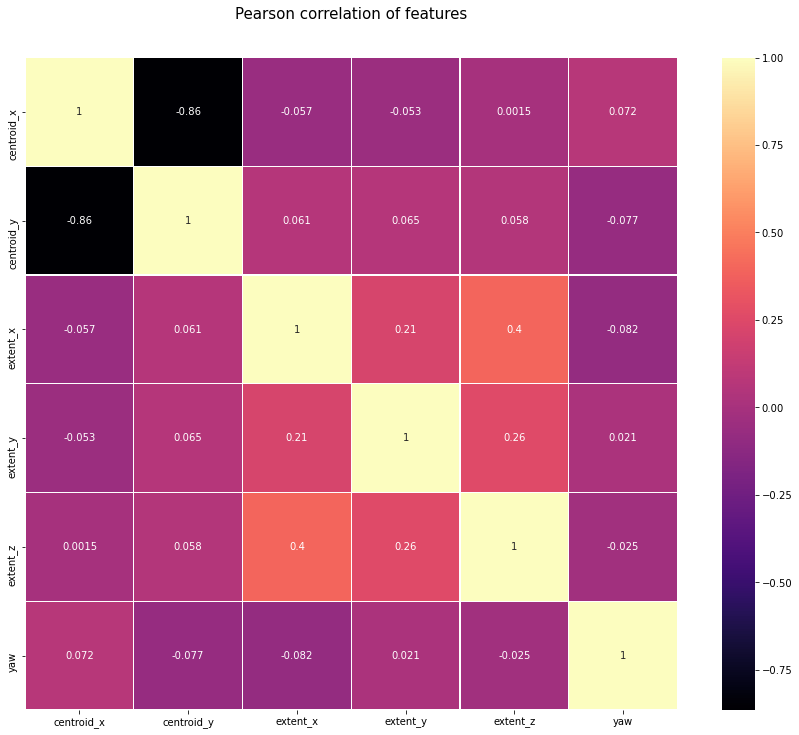

In [14]:
import seaborn as sns
colormap = plt.cm.magma
cont_feats = ["centroid_x", "centroid_y", "extent_x", "extent_y", "extent_z", "yaw"]
plt.figure(figsize=(16,12));
plt.title('Pearson correlation of features', y=1.05, size=15);
sns.heatmap(agents[cont_feats].corr(),linewidths=0.1,vmax=1.0, square=True, cmap=colormap, linecolor='white', annot=True);

Here we can extrapolate that the variables **centroid_x** and **centroid_y** have strongly negative correlations, and the strongest correlations are between **extent_z** and **extent_x** more than any other, coming in at 0.4. We can also try using an XGBoost/LightGBM model as kkiller has demonstrated in his brilliant kernel as an alternative approach to the problem.

### centroid_x and centroid_y

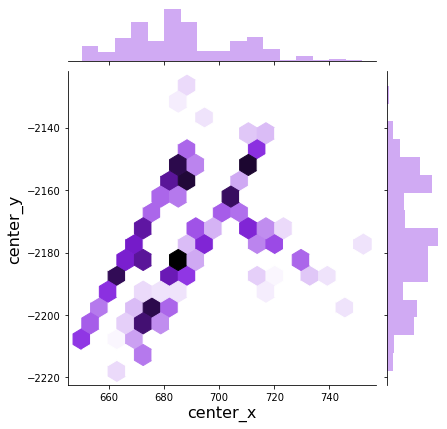

In [15]:
import seaborn as sns
plot = sns.jointplot(x=agents['centroid_x'][:1000], y=agents['centroid_y'][:1000], kind='hexbin', color='blueviolet')
plot.set_axis_labels('center_x', 'center_y', fontsize=16)

plt.show()

It seems like the two centroids have a somewhat strongly negative correlation and seemingly similar variable distributions. It seems that as such there is a negative correlation between both the variables.

### extent_x, extent_y and extent_z

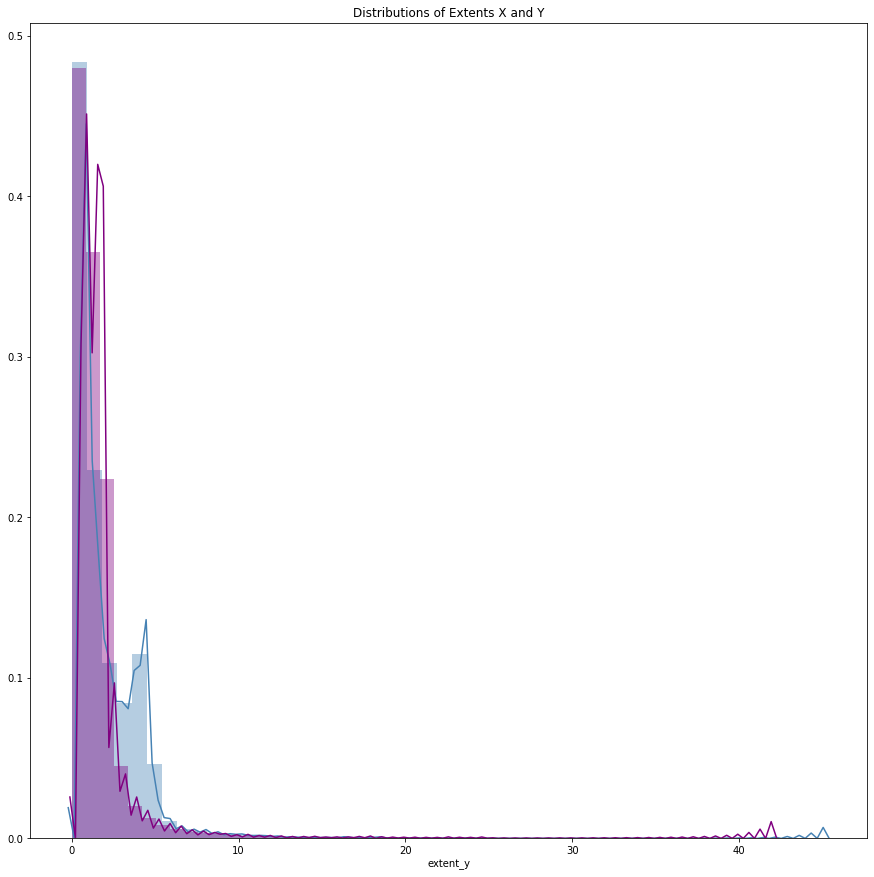

In [16]:
fig = plt.figure(figsize=(15, 15));
sns.distplot(agents['extent_x'], color='steelblue');
sns.distplot(agents['extent_y'], color='purple');

plt.title("Distributions of Extents X and Y");

It seems both the distributions of extent X and extent Y are heavily right skewed, as is centroid X. However, I have left out extent Z is order for readability of the plot, let's look at it now.

Try to smooth the data and get:

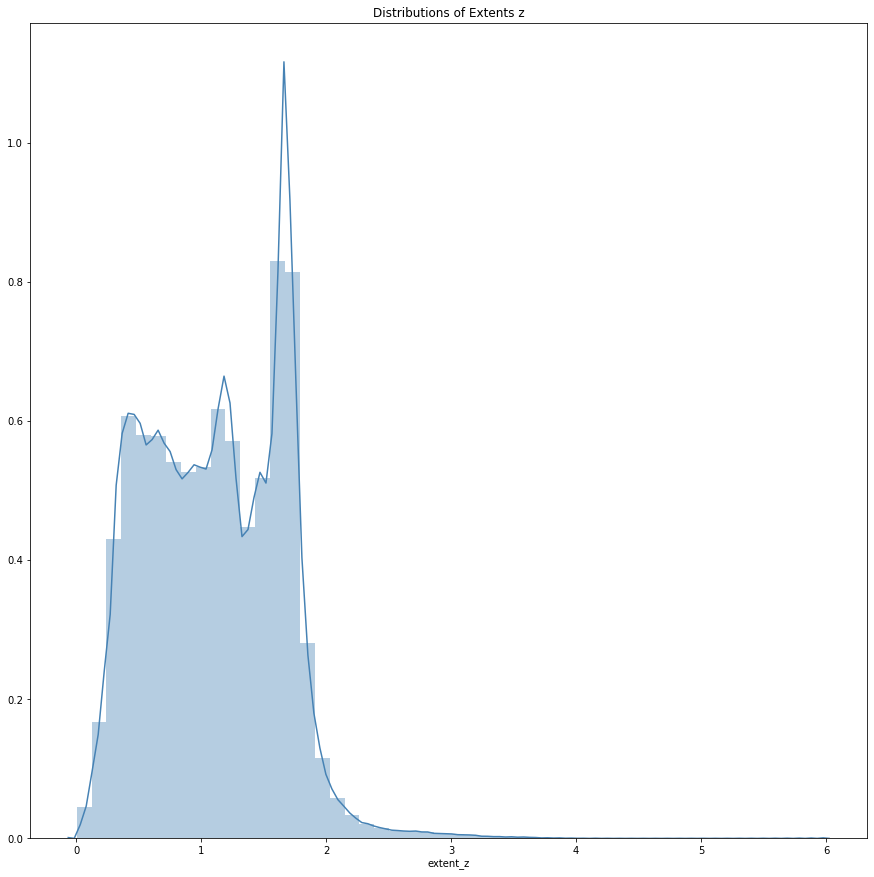

In [17]:
fig = plt.figure(figsize=(15, 15));
sns.distplot(agents['extent_z'], color='steelblue');

plt.title("Distributions of Extents z");

Once again, we have a right-skewed distribution as is the same with all the `extent` variables. 

### yaw

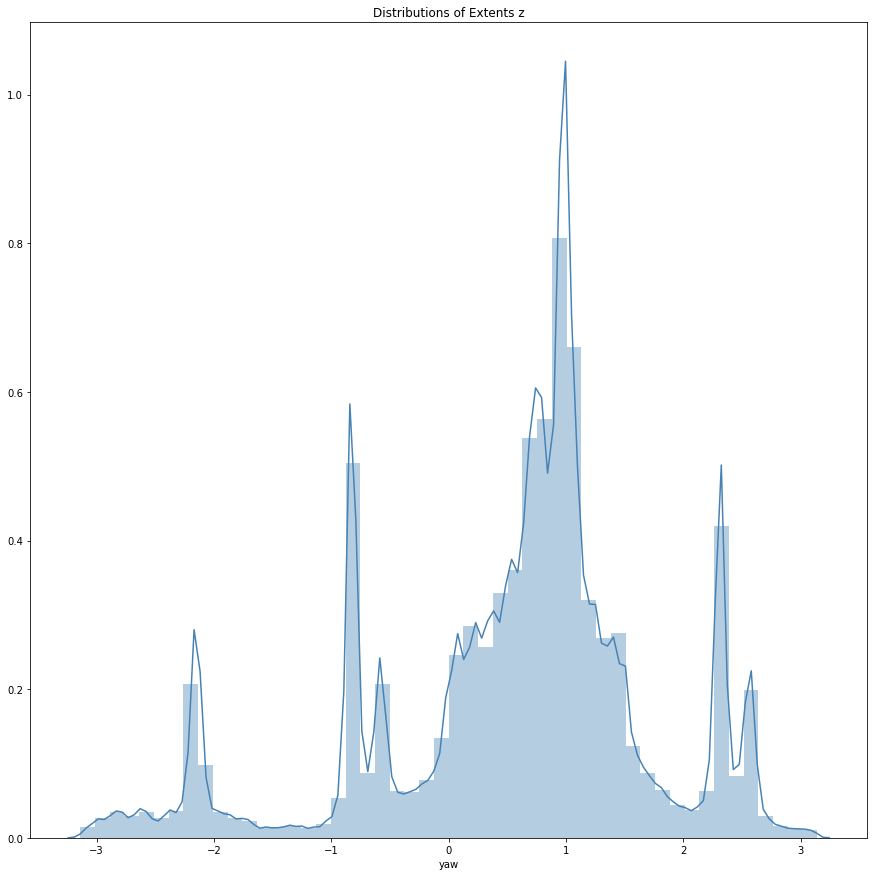

In [18]:
fig = plt.figure(figsize=(15, 15));
sns.distplot(agents['yaw'], color='steelblue');

plt.title("Distributions of Extents z");

So yes it seems like this distribution has several "protrusions" as I shall call them. We can now move on to exploring the frames data to check how feasible it is for our tabular purposes.

In [19]:
frms = pd.read_csv("../input/lyft-motion-prediction-autonomous-vehicles-as-csv/frames_0_124167_124167.csv")
frms.head()

,timestamp,agent_index_interval_start,agent_index_interval_end,traffic_light_faces_index_interval_start,traffic_light_faces_index_interval_end,ego_translation_x,ego_translation_y,ego_translation_z,ego_rotation_xx,ego_rotation_xy,ego_rotation_xz,ego_rotation_yx,ego_rotation_yy,ego_rotation_yz,ego_rotation_zx,ego_rotation_zy,ego_rotation_zz,frame_db_id,scene_db_id
0,1572643684801892606,0,38,0,0,680.619751,-2183.327637,288.541138,0.546733,-0.837294,0.004591,0.835287,0.545026,-0.072402,0.058120,0.043419,0.997365,0,0
1,1572643684901714926,38,85,0,0,681.185608,-2182.422363,288.608124,0.547081,-0.837060,0.005748,0.835098,0.545301,-0.072513,0.057564,0.044470,0.997351,1,0
2,1572643685001499246,85,142,0,0,681.764709,-2181.522705,288.680939,0.547960,-0.836487,0.005308,0.834573,0.546253,-0.071379,0.056808,0.043542,0.997435,2,0
3,1572643685101394026,142,200,0,0,682.341431,-2180.624268,288.755920,0.549123,-0.835734,0.003578,0.833714,0.547487,-0.071972,0.058190,0.042504,0.997400,3,0
4,1572643685201412346,200,254,0,0,682.919800,-2179.730469,288.827393,0.550422,-0.834887,-0.000075,0.832540,0.548881,-0.074874,0.062552,0.041149,0.997193,4,0


## Ego Rotation Correlations

Next we examine the nine rotation components (`ego_rotation_xx`, ..., `ego_rotation_zz`) in the frames CSV.  The heatmap reveals:

- Off-diagonal terms involving Y and Z are mostly uncorrelated.
- Components with X correlate strongly with Z, suggesting that changes in roll (X axis) often accompany changes in yaw (Z axis).

These patterns may influence how you parameterise the orientation of agents.

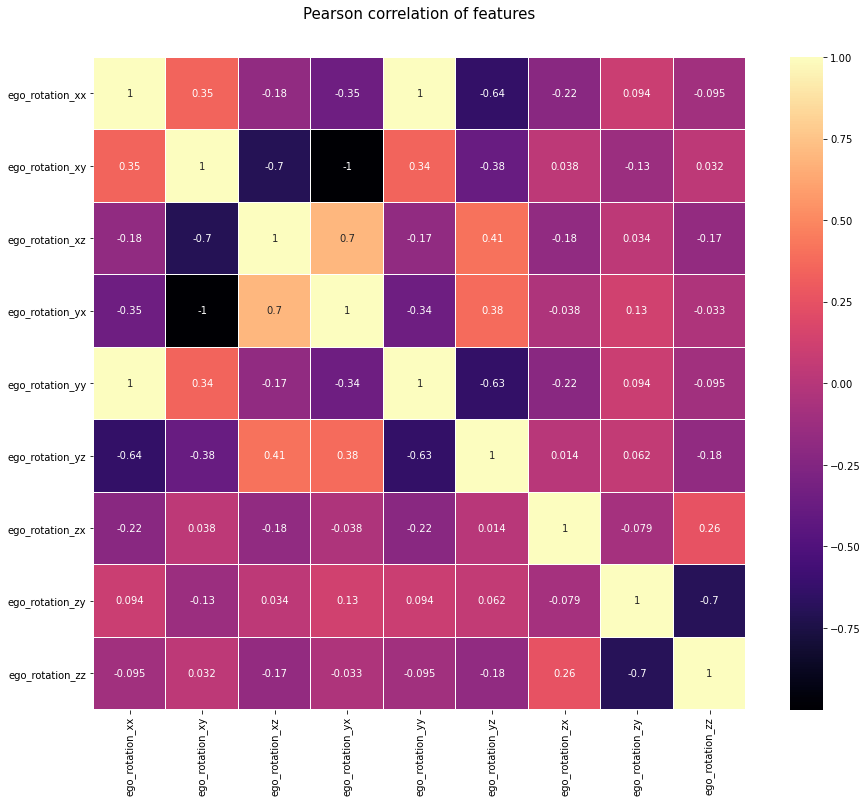

In [20]:
import seaborn as sns
colormap = plt.cm.magma
cont_feats = ["ego_rotation_xx", "ego_rotation_xy", "ego_rotation_xz", "ego_rotation_yx", "ego_rotation_yy", "ego_rotation_yz", "ego_rotation_zx", "ego_rotation_zy", "ego_rotation_zz"]
plt.figure(figsize=(16,12));
plt.title('Pearson correlation of features', y=1.05, size=15);
sns.heatmap(frms[cont_feats].corr(),linewidths=0.1,vmax=1.0, square=True, 
            cmap=colormap, linecolor='white', annot=True);


Things to note from this correlation analysis:
1. The rotation coordinates with `y` and `z` seem to be uncorrelated most of the time
2. The coordinates which have `x` are correlated strongly with the z-dimensional rotation (could this be indicative of something? I very much think so)

## Augmentation Preview

We demonstrate Albumentations’ `Cutout` transformation on a BEV image and its target points:

- A mask is dropped over the raster; keypoints remain visible because `remove_invisible=False`.
- The pixel distribution shifts slightly (the peak at 0 decreases).  Aggressive cutouts may remove useful map context, so augmentation should be used carefully.

The next cells generate the transformed image and show before/after histograms.

Plot with the cutout transformation:

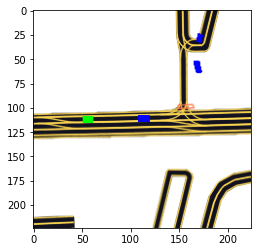

In [21]:
plot_with_tfms([A.Cutout()])

Albumentations basically uses the keypoints provided in order to facilitate augmentation. (using cutout is dangerous because of loss of information possibilities btw, this is just for an example).

Let's see the pixel distributions for the above plot:

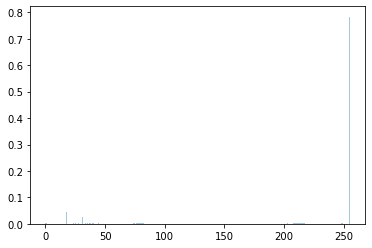

In [22]:
tfms = A.Compose([A.Cutout()], keypoint_params=A.KeypointParams(format="xy", remove_invisible=False))
im = tfms(image=train_dataset_a[0]['image'], keypoints=train_dataset_a[0]['target_positions'])
keypoints = im['keypoints']
im = train_dataset_a.rasterizer.to_rgb(im['image'].transpose(1, 2, 0))
sns.distplot(im.ravel(), bins=256, kde=False, norm_hist=True);  # fallback for seaborn<0.11

And how much they have changed from the original:

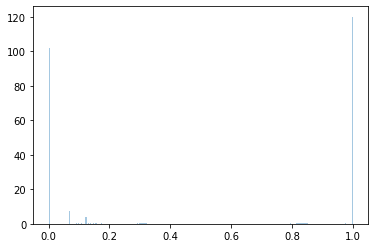

In [23]:
sns.distplot(train_dataset_a[0]['image'].ravel(), bins=256, kde=False, norm_hist=True);

Not much difference here except that we've shaved a lot off the `0.0` peak which is the effect of the cutout augmentatioin.

## Baseline Model

We load a separate `agent_motion_config.yaml` for training and initialise a rasteriser.  The baseline model (`LyftModel`) is adapted from the official L5Kit example:

- Backbone: FPN with a ResNeXt encoder, modified to accept channels for history frames.
- The segmentation head is replaced with a small CNN/MLP stack that outputs `(Δx, Δy)` for each future frame.
- Dropout layers are inserted for regularisation.

In [24]:
cfg2 = load_config_data("../input/lyft-config-files/agent_motion_config.yaml")
cfg2 = omegaconf.OmegaConf.create(cfg2)
train_cfg = omegaconf.OmegaConf.to_container(cfg2.train_data_loader)
validation_cfg = omegaconf.OmegaConf.to_container(cfg2.val_data_loader)
# Rasterizer
rasterizer = build_rasterizer(cfg2, dm)

Now we pretty-print the structure of our configuration. Hydra allows you to easily manage your configuration structure and schema whenever you train a machine learning model - it is also, as an additional benefit, part of the official **Pytorch Ecosystem.**

In [25]:
import omegaconf
print(omegaconf.OmegaConf.to_yaml(cfg2, resolve=True))

format_version: 4
model_params:
  model_architecture: resnet50
  history_num_frames: 0
  history_step_size: 1
  history_delta_time: 0.1
  future_num_frames: 50
  future_step_size: 1
  future_delta_time: 0.1
raster_params:
  raster_size:
  - 224
  - 224
  pixel_size:
  - 0.5
  - 0.5
  ego_center:
  - 0.25
  - 0.5
  map_type: py_semantic
  satellite_map_key: aerial_map/aerial_map.png
  semantic_map_key: semantic_map/semantic_map.pb
  dataset_meta_key: meta.json
  filter_agents_threshold: 0.5
train_data_loader:
  key: scenes/sample.zarr
  batch_size: 12
  shuffle: true
  num_workers: 16
val_data_loader:
  key: scenes/sample.zarr
  batch_size: 12
  shuffle: false
  num_workers: 16
train_params:
  checkpoint_every_n_steps: 10000
  max_num_steps: 5
  eval_every_n_steps: 10000



## Training with Catalyst

We train the baseline model using Catalyst on small subsets to verify that the loop runs:

- **Subsets**: only 1 100 training samples and 50 validation samples, to keep the demo fast.
- **Loss**: mean squared error (MSE) weighted by `target_availabilities`.
- **Callbacks**: optional Neptune/W&B loggers, early stopping, and a batch overfit callback for debugging.

In [26]:
class LyftModel(torch.nn.Module):
    def __init__(self, cfg: omegaconf.dictconfig.DictConfig):
        super().__init__()
        self.backbone = smp.FPN(encoder_name="resnext50_32x4d", classes=1)
        num_history_channels = (cfg["model_params"]["history_num_frames"] + 1) * 2
        num_in_channels = 3 + num_history_channels
        self.backbone.encoder.conv1 = nn.Conv2d(
            num_in_channels,
             self.backbone.encoder.conv1.out_channels,
            kernel_size= self.backbone.encoder.conv1.kernel_size,
            stride= self.backbone.encoder.conv1.stride,
            padding= self.backbone.encoder.conv1.padding,
            bias=False,
        ) 
        backbone_out_features = 14
        num_targets = 2 * cfg["model_params"]["future_num_frames"]
        self.head = nn.Sequential(
            nn.Dropout(0.2),
            nn.Linear(in_features=14, out_features=4096),
        )
        self.backbone.segmentation_head = nn.Sequential(nn.Conv1d(56, 1, kernel_size=3, stride=2), nn.Dropout(0.2), nn.ReLU())
        self.logit = nn.Linear(4096, out_features=num_targets)
        self.logit_final = nn.Linear(128, 12)
        self.num_preds = num_targets * 3
    def forward(self, x):
        x = self.backbone.encoder.conv1(x)
        x = self.backbone.encoder.bn1(x)        
        x = self.backbone.encoder.relu(x)
        x = self.backbone.encoder.maxpool(x)        
        x = self.backbone.encoder.layer1(x)
        x = self.backbone.encoder.layer2(x)
        x = self.backbone.encoder.layer3(x)
        x = self.backbone.encoder.layer4(x)        
        x = self.backbone.decoder.p5(x)
        x = self.backbone.decoder.seg_blocks[0](x)
        x = self.backbone.decoder.merge(x)
        x = self.backbone.segmentation_head(x)
        x = self.backbone.encoder.maxpool(x)
        x = torch.flatten(x, 1)
        x = self.head(x)
        x = self.logit(x)   
        x = x.permute(1, 0)
        x = self.logit_final(x)
        return x

In [27]:
import torch; print("CUDA:", torch.cuda.is_available(), torch.cuda.get_device_name(0) if torch.cuda.is_available() else None)

CUDA: True Tesla P100-PCIE-16GB


## Part 1: Training with Catalyst

We train the baseline model using Catalyst on small subsets to verify that the loop runs:

- **Subsets**: only 1 100 training samples and 50 validation samples, to keep the demo fast.
- **Loss**: mean squared error (MSE) weighted by `target_availabilities`.
- **Callbacks**: optional Neptune/W&B loggers, early stopping, and a batch overfit callback for debugging.

In [28]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = LyftModel(cfg2)
model.to(device)
train_zarr = ChunkedDataset(dm.require(train_cfg['key'])).open()
train_dataset = AgentDataset(cfg2, train_zarr, rasterizer)
del train_cfg['key']
subset = torch.utils.data.Subset(train_dataset, range(0, 1100))
train_dataloader = DataLoader(subset,
                              **train_cfg)
val_zarr = ChunkedDataset(dm.require(validation_cfg['key'])).open()
del validation_cfg['key']

val_dataset = AgentDataset(cfg2, val_zarr, rasterizer)
subset = torch.utils.data.Subset(val_dataset, range(0, 50))
val_dataloader = DataLoader(subset,
                              **validation_cfg)

Downloading: "https://download.pytorch.org/models/resnext50_32x4d-7cdf4587.pth" to /root/.cache/torch/checkpoints/resnext50_32x4d-7cdf4587.pth


This takes a very small subset of the data that we have here (mainly because this training pipeline is purely for demonstration purposes with regards to Catalyst).

In [29]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.02)

loaders = {
    "train": train_dataloader,
    "valid": val_dataloader
}

class LyftRunner(dl.SupervisedRunner):
    def predict_batch(self, batch):
        return self.model(batch[0].to(self.device).view(batch[0].size(0), -1))
    def _handle_batch(self, batch):
        x, y = batch['image'], batch['target_positions']
        y_hat = self.model(x).view(y.shape)
        target_availabilities = batch["target_availabilities"].unsqueeze(-1)
        criterion = torch.nn.MSELoss(reduction="none")
        loss = criterion(y_hat, y)
        loss = loss * target_availabilities
        loss = loss.mean()
        self.batch_metrics.update(
            {"loss": loss}
        )


Few things:
+ Configuration of the data loaders
+ Beginning the Catalyst process
+ Neptune, wandb  initialization

In [30]:
%%time
device = utils.get_device()
runner = LyftRunner(device=device, input_key="image", input_target_key="target_positions", output_key="logits")
if MONITORING:

    runner.train(
        model=model,
        optimizer=optimizer,
        loaders=loaders,
        logdir="../working",
        num_epochs=4,
        verbose=True,
        load_best_on_end=True,
        callbacks=[neptune_logger, BatchOverfitCallback(train=10, valid=0.5), 
                  EarlyStoppingCallback(
            patience=2,
            metric="loss",
            minimize=True,
        ), WandbLogger(project="dertaismus",name= 'Example')
                  ]
    )
else:
    runner.train(
        model=model,
        optimizer=optimizer,
        loaders=loaders,
        logdir="../working",
        num_epochs=4,
        verbose=True,
        load_best_on_end=True,
        callbacks=[BatchOverfitCallback(train=10, valid=0.5), 
                  EarlyStoppingCallback(
            patience=2,
            metric="loss",
            minimize=True,
        )
                  ]
    )
    
# train for more steps and loss will not be low
# or at least not as pathetic as the loss over here    

1/4 * Epoch (train): 100% 92/92 [01:04<00:00,  1.42it/s, loss=123.791]
1/4 * Epoch (valid): 100% 5/5 [00:04<00:00,  1.11it/s, loss=233.935]
[2025-09-23 13:47:39,724] 
1/4 * Epoch 1 (_base): lr=0.0200 | momentum=0.9000
1/4 * Epoch 1 (train): loss=57.8192
1/4 * Epoch 1 (valid): loss=193.1195
2/4 * Epoch (train): 100% 92/92 [01:03<00:00,  1.44it/s, loss=92.744]
2/4 * Epoch (valid): 100% 5/5 [00:04<00:00,  1.11it/s, loss=191.288]
[2025-09-23 13:48:53,659] 
2/4 * Epoch 2 (_base): lr=0.0200 | momentum=0.9000
2/4 * Epoch 2 (train): loss=48.4121
2/4 * Epoch 2 (valid): loss=165.4715
3/4 * Epoch (train): 100% 92/92 [01:03<00:00,  1.45it/s, loss=19.474]
3/4 * Epoch (valid): 100% 5/5 [00:04<00:00,  1.11it/s, loss=201.739]
[2025-09-23 13:50:08,855] 
3/4 * Epoch 3 (_base): lr=0.0200 | momentum=0.9000
3/4 * Epoch 3 (train): loss=45.2165
3/4 * Epoch 3 (valid): loss=168.9254
4/4 * Epoch (train): 100% 92/92 [01:02<00:00,  1.46it/s, loss=13.189]
4/4 * Epoch (valid): 100% 5/5 [00:04<00:00,  1.12it/s, loss

And this is how the Neptune metrics look like:
![](https://i.imgur.com/uspP0q0.png)

To properly work with Neptune callbacks, replace the `U.` fields in the callback class with your API token, project name etc. Then, add it as a callback to Catalyst and watch the magic happen.

## Part 2: Training with Kekas

For comparison, we run a lightweight training loop using Kekas:

- `DataOwner` wraps the same subsets used above.
- `step_fn` defines how model outputs map to the target tensor.
- `Keker` handles freezing/unfreezing layers and running epochs (`keker.kek`).

Note that the loss here doesn’t yet multiply by `target_availabilities` like in Catalyst, so expect different loss values.

In [31]:
dataowner = DataOwner(train_dataloader, val_dataloader, None)

def step_fn(model: torch.nn.Module, batch: torch.Tensor) -> torch.Tensor:
    device = next(model.parameters()).device
    x = batch["image"].to(device, non_blocking=True)
    t = batch["target_positions"].to(device, non_blocking=True)  # (N, T, 2)

    y = model(x)
    # If the model outputs (T*2, M) where M ≥ N, slice the first N columns
    if y.ndim == 2 and y.shape[0] == t.shape[1] * 2 and y.shape[1] >= t.shape[0]:
        y = y[:, : t.shape[0]]
        return y.permute(1, 0).contiguous().view(t.shape[0], t.shape[1], 2)

    # existing handling for (N, T*2)
    if y.ndim == 2 and y.shape[0] == t.shape[0] and y.shape[1] == t.shape[1] * 2:
        return y.view(t.shape[0], t.shape[1], 2)

    # existing handling for 3‑D variants
    if y.ndim == 3 and y.numel() == t.numel():
        return y.view_as(t)

    raise RuntimeError(f"step_fn: cannot align pred {tuple(y.shape)} to target {tuple(t.shape)}")

Keker is the equivalent of a Catalyst Runner.

In [32]:
keker = Keker(model=model,
              dataowner=dataowner,
              criterion=torch.nn.MSELoss(),
              step_fn=step_fn,
              target_key="target_positions",
              opt=torch.optim.SGD,
              opt_params={"momentum": 0.99})

And now we kek (train) our model!

In [33]:
keker.kek( lr=1e-3, 
            epochs=5,                  
            logdir='train_logs')

keker.plot_kek('train_logs')

Epoch 1/5: 100% 92/92 [00:24<00:00,  3.72it/s, loss=58.2840, val_loss=411.8206]
Epoch 2/5: 100% 92/92 [00:24<00:00,  3.73it/s, loss=46.9445, val_loss=396.1725]
Epoch 3/5: 100% 92/92 [00:26<00:00,  3.50it/s, loss=41.2729, val_loss=366.7998]
Epoch 4/5: 100% 92/92 [00:24<00:00,  3.71it/s, loss=67.7450, val_loss=406.6578]
Epoch 5/5: 100% 92/92 [00:24<00:00,  3.76it/s, loss=59.7274, val_loss=398.6523]


## Next Steps & Notes

- Fill in the results (loss curves, possible ADE/FDE metrics) after running the training loops.  
- For more realistic training, use the full train/val splits instead of tiny subsets.  
- Consider multi‑modal outputs or graph-based features to improve trajectory diversity.  